In [83]:
import re
import time
from tqdm import tqdm
 
import numpy as np
import pandas as pd
 

import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from selenium import webdriver

import nltk
from nltk.corpus import stopwords as nltk_stopwords
from pymystem3 import Mystem
from wordcloud import WordCloud

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression

from sklearn.metrics import *

In [35]:
positive = pd.read_csv(r'data/community_datasets/mokoron_raw_dataset/positive.csv',
                       sep = ',',
                       header= None
                      )
negative = pd.read_csv(r'data/community_datasets/mokoron_raw_dataset/negative.csv',
                       sep = ',',
                       header= None
                      )

C:\Users\Artem\AppData\Local\Temp\ipykernel_24480\3298960464.py:1: DtypeWarning: Columns (0,1,4,5,6,7,8,9,10,11) have mixed types. Specify dtype option on import or set low_memory=False.
  positive = pd.read_csv(r'data/community_datasets/mokoron_raw_dataset/positive.csv',
C:\Users\Artem\AppData\Local\Temp\ipykernel_24480\3298960464.py:5: DtypeWarning: Columns (0,1,4,5,6,7,8,9,10,11) have mixed types. Specify dtype option on import or set low_memory=False.
  negative = pd.read_csv(r'data/community_datasets/mokoron_raw_dataset/negative.csv',


In [36]:
positive_text = pd.DataFrame(positive.iloc[:, 3])
negative_text = pd.DataFrame(negative.iloc[:, 3])

In [37]:
positive_text['label'] = [1] * positive_text.shape[0]
negative_text['label'] = [0] * negative_text.shape[0]

In [38]:
labeled_tweets = pd.concat([positive_text, negative_text])

In [39]:
labeled_tweets.index = range(labeled_tweets.shape[0])

In [40]:
labeled_tweets.columns = ['text', 'label']
labeled_tweets

,text,label
0,ttext,1
1,"@first_timee хоть я и школота, но поверь, у на...",1
2,"Да, все-таки он немного похож на него. Но мой ...",1
3,RT @KatiaCheh: Ну ты идиотка) я испугалась за ...,1
4,"RT @digger2912: ""Кто то в углу сидит и погибае...",1
...,...,...
226831,Но не каждый хочет что то исправлять:( http://...,0
226832,скучаю так :-( только @taaannyaaa вправляет мо...,0
226833,"Вот и в школу, в говно это идти уже надо(",0
226834,"RT @_Them__: @LisaBeroud Тауриэль, не грусти :...",0


In [24]:
# Оставим в тексте только кириллические символы
def clear_text(text):
    clear_text = re.sub(r'[^А-яЁё]+', ' ', text).lower()
    return " ".join(clear_text.split())
    

# напишем функцию удаляющую стоп-слова
def clean_stop_words(text, stopwords):
    text = [word for word in text.split() if word not in stopwords]
    return " ".join(text)

In [25]:
stopwords = set(nltk_stopwords.words('russian'))
np.array(stopwords)

array({'под', 'при', 'какой', 'даже', 'его', 'от', 'как', 'она', 'уж', 'потому', 'всего', 'ты', 'моя', 'об', 'нас', 'всегда', 'про', 'сейчас', 'более', 'ему', 'есть', 'эти', 'ну', 'им', 'ей', 'ведь', 'о', 'раз', 'тут', 'во', 'такой', 'вдруг', 'себе', 'нет', 'тоже', 'была', 'из', 'можно', 'ее', 'ним', 'потом', 'нее', 'над', 'опять', 'то', 'если', 'два', 'этом', 'но', 'ж', 'было', 'где', 'один', 'а', 'все', 'ни', 'бы', 'после', 'иногда', 'да', 'того', 'тем', 'теперь', 'всю', 'так', 'мне', 'этот', 'тогда', 'чтобы', 'себя', 'нибудь', 'что', 'вас', 'хорошо', 'тебя', 'какая', 'быть', 'меня', 'там', 'в', 'зачем', 'на', 'тот', 'никогда', 'с', 'не', 'еще', 'со', 'впрочем', 'сам', 'когда', 'совсем', 'же', 'по', 'только', 'или', 'лучше', 'за', 'они', 'хоть', 'он', 'кто', 'к', 'разве', 'мой', 'том', 'вы', 'другой', 'больше', 'чуть', 'и', 'здесь', 'был', 'этой', 'ничего', 'у', 'может', 'нельзя', 'чтоб', 'конечно', 'них', 'перед', 'ней', 'уже', 'надо', 'будто', 'свою', 'почти', 'этого', 'были', 'куд

In [43]:
# Протестируем работу функции очистки текста
text = labeled_tweets['text'][np.random.randint(labeled_tweets.shape[0])]
print(text)
print('=======================================')
print(clean_stop_words((clear_text(text)), stopwords))

ИЛИ НЕОТМЕНИЛИ АХАХАХА,ебать сидим с Элькой дома все в школе походу:)
неотменили ахахаха ебать сидим элькой дома школе походу


In [45]:
start_clean = time.time()

labeled_tweets['text_clear'] = labeled_tweets['text']\
                                .apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 2.19 секунд


In [46]:
labeled_tweets = labeled_tweets[['text_clear', 'label']]
labeled_tweets

,text_clear,label
0,,1
1,школота поверь самое общество профилирующий пр...,1
2,таки немного похож мальчик равно,1
3,идиотка испугалась,1
4,углу сидит погибает голода ещё порции взяли хо...,1
...,...,...
226831,каждый хочет исправлять,0
226832,скучаю вправляет мозги равно скучаю,0
226833,школу говно это идти,0
226834,тауриэль грусти обнял,0


In [47]:
labeled_tweets.to_csv(r'data/clean_dataset/labeled_tweets.csv')

In [6]:
labeled_texts_1 = pd.read_excel(
    'data/community_datasets/linis_crowd_dataset/doc_comment_summary.xlsx',
    sheet_name = 0,
    header=None
    )

In [7]:
labeled_texts_1['label'] = pd.to_numeric(labeled_texts_1.iloc[:, 1], errors='coerce')

In [8]:
labeled_texts_1 = labeled_texts_1[[0, 'label']]

In [9]:
labeled_texts_1.columns = ['text', 'label']

In [10]:
labeled_texts_1.label.value_counts()

label
 0.0        13930
-1.0         9203
 1.0         1795
-2.0         1534
 2.0          365
 22158.0        2
 21887.0        1
 23486.0        1
 23523.0        1
Name: count, dtype: int64

In [11]:
ind_drop = labeled_texts_1.query('label > 2 or label < - 2').index

In [12]:
labeled_texts_1 = labeled_texts_1.query('index not in @ind_drop')

In [13]:
for _ in range(4):
    
    sample = labeled_texts_1.sample(n = 1)
    
    print('label: ', sample.label.values[0])
    
    print(sample['text'].values[0][:200]) 
    
    print()

label:  0.0
ороче, не надо кирпичом ружья чистить. (То-то царь обрадуется, когда узнает!)  Тов.sapojnik открывает для себя технологию укладки плитки.Эх, жаль его с самого начала не спросили - и теперь везде и пов

label:  -1.0
Мы делали фильм про Нерпенка :) наша с'емочная команда по четыре раза в год ездила на Байкал. К сожалению я лично - нет, так как жить в палатка на льду это не для меня.  Но фильм вышел красивый. Байка

label:  1.0
Включающего и математику, и физику, и биологию, и философию. На узкого специалиста, думающего  не выше пробирки , человека натаскать невелика сложность. Сапиенса вырастить сложнее.   Есть база, котора

label:  0.0
Когда в начале 90-х Литва принимала нулевой вариант гржданства, они рассуждали примерно так: нас дофига, и русские попросту не справятся, в отличие от латышей и эстов.  А споры жмуди между собою идут 



In [14]:
selected = labeled_texts_1.query('label != 0')

In [15]:
selected.label.value_counts()

label
-1.0    9203
 1.0    1795
-2.0    1534
 2.0     365
Name: count, dtype: int64

In [16]:
selected.loc[:, 'label_binary'] = np.nan

C:\Users\Artem\AppData\Local\Temp\ipykernel_24480\2569160575.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected.loc[:, 'label_binary'] = np.nan


In [17]:
selected.loc[((selected['label'] == -1) |
         (selected['label'] == -2)), 'label_binary'] = 0

In [18]:
selected.loc[((selected['label'] == 1) |
         (selected['label'] == 2)), 'label_binary'] = 1

In [19]:
selected.label_binary.value_counts()

label_binary
0.0    10737
1.0     2160
Name: count, dtype: int64

In [20]:
for _ in range(3):
    
    sample_neg = selected.query('label_binary == 0').sample(n = 1)
    
    sample_pos = selected.query('label_binary == 1').sample(n = 1)
    
    print('label: ', sample_pos.label_binary.values[0])
    
    print(sample_pos['text'].values[0][:200]) 
    
    print('label: ', sample_neg.label_binary.values[0])
    
    print(sample_neg['text'].values[0][:200]) 
    
    print()

label:  1.0
ороший, наверное, госпиталь! Раз даже стены помогают.Скорейшего выздоравливания Вашей жене. Но случай интересный! Асцит и кахексия регрессирующие без лечения...Моих знаний не хватает, что бы это понят
label:  0.0
Знаете, я бы много дал, чтобы понять: а в чем же именно эти разговоры заключались и как они происходили?Почему я это спрашиваю? Ну, как я говорил выше: надоело читать слова молитв в пустоту. Говорят, 

label:  1.0
икогда не был, хотя родственники имеются. Хочу побывать. С праздником - москвичи!  Мне Москва нравится, но жить бы я в ней не хотела...  непростой город  Москва !!!!!!!!!!!!! ураааааааааааааааааа  Я п
label:  0.0
ольшой оригинал!:))  Брезгливо.  Ну и сказали бы ему прямо.А то шантажировать увольнением коллег начали.У нас сын за отца не отвечает, в коллега за коллегу - тем более.  Издержки сегодняшней бюрократи

label:  1.0
ознавательно. Что касается Цзян Цинь - то она оказалась хитрее и понятливее своей предшественницы, и по свидетельству Владимирова, сам

In [26]:
start_clean = time.time()

selected['text_clear'] = selected['text']\
                               .apply(lambda x:
                                      clean_stop_words(
                                        clear_text(str(x)),
                                        stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 0.74 секунд


C:\Users\Artem\AppData\Local\Temp\ipykernel_24480\3338079758.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected['text_clear'] = selected['text']\


In [28]:
def lemmatize(df : (pd.Series, pd.DataFrame),
              text_column : (None, str),
              n_samples : int,
              break_str = 'br',
             ) -> pd.Series:
    
    result = []
    
    m = Mystem()    
    
    for i in tqdm(range((df.shape[0] // n_samples) + 1)) :
        
        start = i * n_samples
        
        stop = start + n_samples
        
        sample = break_str.join(df[text_column][start : stop].values)
        
        lemmas = m.lemmatize(sample)
        
        lemm_sample = ''.join(lemmas).split(break_str)
        
        result += lemm_sample
        
    return pd.Series(result, index = df.index)

In [29]:
selected['lemm_clean_tex'] = lemmatize(
    df = selected,
    text_column = 'text_clear',
    n_samples = 100,
    break_str = 'br',
    )

Installing mystem to C:\Users\Artem/.local/bin\mystem.exe from http://download.cdn.yandex.net/mystem/mystem-3.1-win-64bit.zip
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 130/130 [01:35<00:00,  1.36it/s]
C:\Users\Artem\AppData\Local\Temp\ipykernel_24480\959808114.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected['lemm_clean_tex'] = lemmatize(


In [30]:
selected.head()

,text,label,label_binary,text_clear,lemm_clean_tex
0,Но при мужчине ни одна приличная женщина не по...,-1.0,0.0,мужчине одна приличная женщина пойдет лазить р...,мужчина один приличный женщина пойти лазить ра...
1,Украина это часть Руси искусственно отделенная...,-1.0,0.0,украина это часть руси искусственно отделенная...,украина это часть русь искусственно отделять к...
2,Как можно говорить об относительно небольшой к...,-1.0,0.0,говорить относительно небольшой коррупции обра...,говорить относительно небольшой коррупция обра...
5,Государство не может сейчас платить больше и м...,-1.0,0.0,государство платить посмотрите денежный поток ...,государство платить посмотреть денежный поток ...
8,эксплуатируемые способны только на бунты - бес...,-1.0,0.0,эксплуатируемые способны бунты бессмысленные б...,эксплуатируемые способный бунт бессмысленный б...


In [32]:
labeled_tweets = pd.read_csv(r'data/clean_dataset/labeled_tweets.csv')

In [48]:
labeled_tweets['lemm_text_clear'] = lemmatize(
    df = labeled_tweets,
    text_column = 'text_clear',
    n_samples = 1000,
    break_str = 'br',
    )

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 227/227 [02:31<00:00,  1.50it/s]


In [49]:
labeled_tweets

,text_clear,label,lemm_text_clear
0,,1,
1,школота поверь самое общество профилирующий пр...,1,школота поверять самый общество профилировать ...
2,таки немного похож мальчик равно,1,таки немного похожий мальчик равно
3,идиотка испугалась,1,идиотка испугалась
4,углу сидит погибает голода ещё порции взяли хо...,1,углу сидеть погибать голод еще порция взять хо...
...,...,...,...
226831,каждый хочет исправлять,0,каждый хотеть исправлять
226832,скучаю вправляет мозги равно скучаю,0,скучаю вправлять мозги равный скучаю
226833,школу говно это идти,0,школу гавно это идти
226834,тауриэль грусти обнял,0,тауриэль грусть обнял


In [50]:
sample_1 = labeled_tweets[['text_clear', 'lemm_text_clear', 'label']]

sample_2 = selected[['text_clear', 'lemm_clean_tex', 'label_binary']]

In [51]:
sample_2.columns = ['text_clear','lemm_text_clear', 'label']

In [52]:
sample_2.isna().sum()

text_clear          0
lemm_text_clear     0
label              41
dtype: int64

In [53]:
sample_2 = sample_2.dropna()
sample_2.isna().sum()

text_clear         0
lemm_text_clear    0
label              0
dtype: int64

In [54]:
joned_text = pd.concat([sample_1, sample_2])

In [55]:
joned_text

,text_clear,lemm_text_clear,label
0,,,1.0
1,школота поверь самое общество профилирующий пр...,школота поверять самый общество профилировать ...,1.0
2,таки немного похож мальчик равно,таки немного похожий мальчик равно,1.0
3,идиотка испугалась,идиотка испугалась,1.0
4,углу сидит погибает голода ещё порции взяли хо...,углу сидеть погибать голод еще порция взять хо...,1.0
...,...,...,...
26864,великое испытание выпало долю наших предков ве...,великое испытание выпадать доля наш предок веч...,1.0
26865,н своему поведению крайне низкий человек прост...,н свой поведение крайне низкий человек прощать...,0.0
26866,многие психологические книги кричат женщины да...,многие психологический книга кричать женщина д...,1.0
26868,многих заставляют многие сами проявляют излишн...,многих заставлять многий сам проявлять излишни...,0.0


In [56]:
joned_text.label.value_counts()

label
0.0    122661
1.0    117072
Name: count, dtype: int64

In [57]:
joned_text.columns = ['text', 'lemm_text', 'label']

In [58]:
joned_text.index = range(joned_text.shape[0])
joned_text.isna().sum()

text         0
lemm_text    0
label        0
dtype: int64

In [59]:
joned_text = joned_text.dropna()
joned_text.isna().sum()

text         0
lemm_text    0
label        0
dtype: int64

In [60]:
sample_2.columns = ['text', 'text_lemm', 'label']
sample_1.columns = ['text', 'text_lemm', 'label']

In [61]:
# предварительно разделим выборку на тестовую и обучающую
train, test = train_test_split(sample_1,
                        test_size = 0.2,
                        random_state = 12348,
                       )

print(train.shape)
print(test.shape)

(181468, 3)
(45368, 3)


In [62]:
train

,text,text_lemm,label
131882,неееет закончился это лучших месяца моей жизни,неееет заканчиваться это хороший месяц мой жизни,0
162021,траур моему любимому папе пусть земля пухом,траур мой любимый папа пусть земля пухом,0
164234,ростовский аэропорт это та пичаль,ростовский аэропорт это тот пичаль,0
66409,сидим любимыми круто рада перевал отжигает люблю,сидим любимый круто рад перевал отжигать люблю,1
157116,уроки нужно сделать контре подготовиться,уроки нужно сделать контра подготовиться,0
...,...,...,...
141717,иммунитет сдавайся хочу заболеть окончательно,иммунитет сдаваться хотеть заболевать окончате...,0
207453,блин понимает уверена напишу ответ типа,блин понимать уверенный написать ответ типа,0
36863,тонкое че психика подите шарющим хотя таких иг...,тонкое че психика пойти шарющий хотя такой игр...,1
146555,забрал мои наушники сучка пол часа иду очень с...,забрал мой наушники сучка пол час идти очень с...,0


In [63]:
# Сравним распределение целевого признака
for sample in [train, test]:    
    print(sample[sample['label'] == 1].shape[0] / sample.shape[0])

0.5064694601803073
0.5070534297302063


In [64]:
count_idf_positive = TfidfVectorizer(ngram_range = (1,1))
count_idf_negative = TfidfVectorizer(ngram_range = (1,1))

tf_idf_positive = count_idf_positive.fit_transform(train.query('label == 1')['text'])
tf_idf_negative = count_idf_negative.fit_transform(train.query('label == 0')['text'])

In [65]:
# Сохраним списки Idf для каждого класса
positive_importance = pd.DataFrame(
    {'word' : count_idf_positive.get_feature_names_out(),
     'idf' : count_idf_positive.idf_
    }).sort_values(by = 'idf', ascending = False)

negative_importance = pd.DataFrame(
    {'word' : count_idf_negative.get_feature_names_out(),
     'idf' : count_idf_negative.idf_
    }).sort_values(by = 'idf', ascending = False)

In [66]:
positive_importance.query('word not in @negative_importance.word and idf < 10.8')

,word,idf
802,азазазаз,10.636795
66427,поставится,10.636795
51640,нямням,10.636795
74244,раком,10.636795
40315,лопату,10.636795
...,...,...
93200,умнички,9.209678
93008,улыбнуло,8.714982
53149,оглядываются,8.536734
73355,разблокируют,8.516531


In [67]:
negative_importance.query('word not in @positive_importance.word and idf < 10')

,word,idf
15798,деградирую,9.917769
62693,расклеилась,9.917769
51737,плинтуса,9.917769
78916,унитазик,9.917769
64190,решите,9.917769
...,...,...
51342,пичалька,8.665006
41267,некролог,8.325138
52340,погибших,8.308331
75011,теракт,8.243792


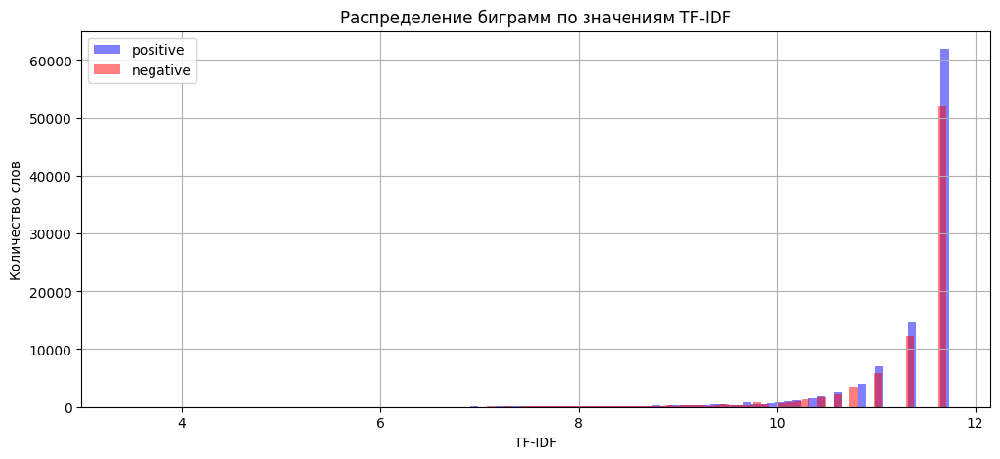

In [68]:
fig = plt.figure(figsize = (12,5))
positive_importance.idf.hist(bins = 100,
                             label = 'positive',
                             alpha = 0.5,
                             color = 'b',
                            )
negative_importance.idf.hist(bins = 100,
                             label = 'negative',
                             alpha = 0.5,
                             color = 'r',
                            )
plt.title('Распределение биграмм по значениям TF-IDF')
plt.xlabel('TF-IDF')
plt.ylabel('Количество слов')
plt.legend()
plt.show()

In [69]:
# Получим векторные представления текстов
count_idf_1 = TfidfVectorizer(ngram_range=(1,1))
tf_idf_base_1 = count_idf_1.fit(sample_1['text'])
tf_idf_train_base_1 = count_idf_1.transform(train['text'])
tf_idf_test_base_1 = count_idf_1.transform(test['text'])
display(tf_idf_test_base_1.shape)
display(tf_idf_train_base_1.shape)

(45368, 170344)

(181468, 170344)

In [70]:
model_lr_base_1 = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

In [71]:
model_lr_base_1.fit(tf_idf_train_base_1, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [72]:
predict_lr_base_proba = model_lr_base_1.predict_proba(tf_idf_test_base_1)

In [74]:
# Получим векторные представления лемматизированных текстов
count_idf_lemm = TfidfVectorizer(ngram_range=(1,1))
tf_idf_lemm = count_idf_lemm.fit(sample_1['text_lemm'])
tf_idf_train_lemm = count_idf_lemm.transform(train['text_lemm'])
tf_idf_test_lemm = count_idf_lemm.transform(test['text_lemm'])
display(tf_idf_train_lemm.shape)
display(tf_idf_test_lemm.shape)

(181468, 134459)

(45368, 134459)

In [75]:
model_lr_lemm = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

In [76]:
model_lr_lemm.fit(tf_idf_train_lemm, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [77]:
predict_lr_lemm_proba = model_lr_lemm.predict_proba(tf_idf_test_lemm)

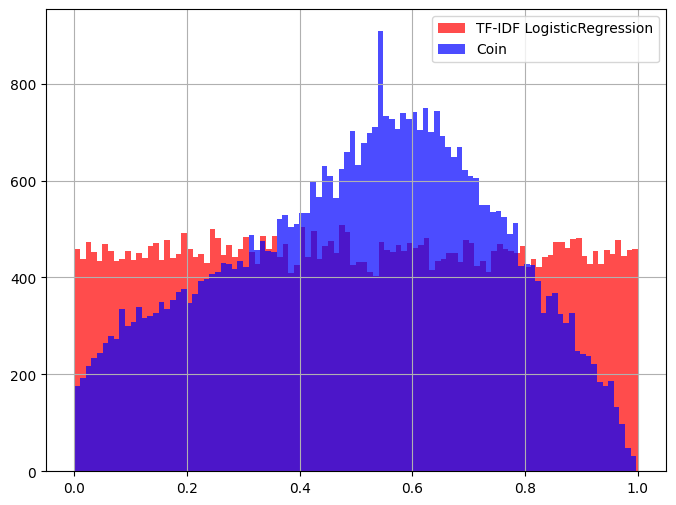

In [78]:
def coin_classifier(X:np.array) -> np.array:
    predict = np.random.uniform(0.0, 1.0, X.shape[0])
    return predict
coin_predict = coin_classifier(tf_idf_test_base_1)
fif = plt.figure(figsize = (8, 6))

pd.Series(coin_predict)\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'r',
                      label = 'TF-IDF LogisticRegression'
                     )

pd.Series(predict_lr_base_proba[:, 1])\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'b',
                      label = 'Coin'
                     )
plt.legend()   
plt.show()

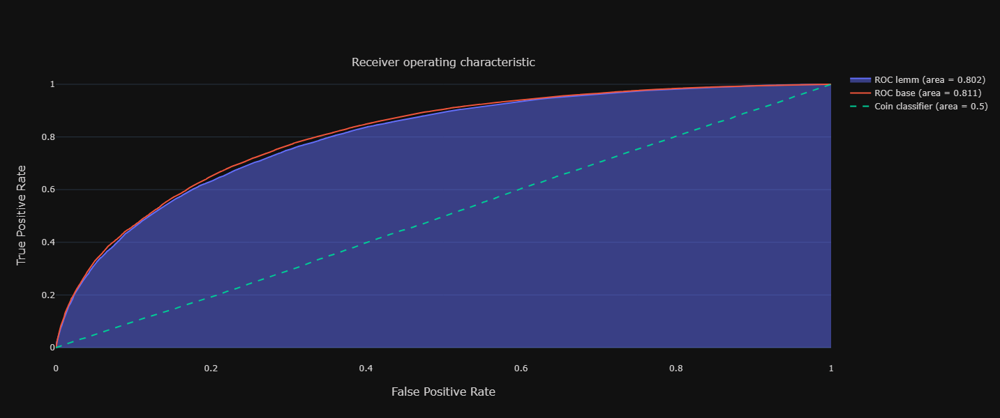

In [85]:
fpr_base, tpr_base, _ = roc_curve(test['label'], predict_lr_base_proba[:, 1])
roc_auc_base = auc(fpr_base, tpr_base)
fpr_lemm, tpr_lemm, _ = roc_curve(test['label'], predict_lr_lemm_proba[:, 1])
roc_auc_lemm = auc(fpr_lemm, tpr_lemm)
fpr_coin, tpr_coin, _ = roc_curve(test['label'], coin_predict)
roc_auc_coin = auc(fpr_base, tpr_base)
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_lemm,
    y = tpr_lemm,
    fill = 'tozeroy',
    name = "ROC lemm (area = %0.3f)" % roc_auc_lemm,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    #fill = 'tozeroy',
    name = "ROC base (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier (area = 0.5)'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

In [86]:
# Выведем матрицы ошибок
confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.69696834, 0.30303166],
       [0.22852547, 0.77147453]])

In [87]:
# Выведем матрицу ошибок
confusion_matrix(test['label'],
                 (predict_lr_lemm_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.68896441, 0.31103559],
       [0.2373935 , 0.7626065 ]])

In [88]:
# Получим веса признаков, то есть множители 
# подобранные логистической регрессией 
# для каждого компонента вектора tf-idf

weights = pd.DataFrame({'words': count_idf_1.get_feature_names_out(),
                        'weights': model_lr_base_1.coef_.flatten()})
weights_min = weights.sort_values(by= 'weights')
weights_max = weights.sort_values(by= 'weights', ascending = False)
weights_min = weights_min[:100]
weights_min['weights'] = weights_min['weights'] * -1
weights_min

,words,weights
85419,обидно,6.999979
39067,жаль,6.146372
28964,грустно,6.016780
98823,печально,5.894508
39024,жалко,5.651660
...,...,...
85711,облом,2.564366
11806,болят,2.558729
85388,обиделся,2.550919
131999,скорбим,2.550866


In [89]:
weights_max = weights_max[:100]
weights_max

,words,weights
20898,вромайдан,4.523754
5502,ахах,4.490050
86118,обожаю,4.321212
5503,ахаха,4.310968
5539,ахахах,4.249840
...,...,...
83548,новому,2.094886
123673,рекомендую,2.092752
37907,евромайдан,2.092622
119465,радости,2.091458


In [90]:
# Воспользуемся библиотекой wordcloud для генерации картинок

wordcloud_positive = WordCloud(background_color="white",
                               colormap = 'Blues',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_max.values))

wordcloud_negative = WordCloud(background_color="black",
                               colormap = 'Reds',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_min.values))

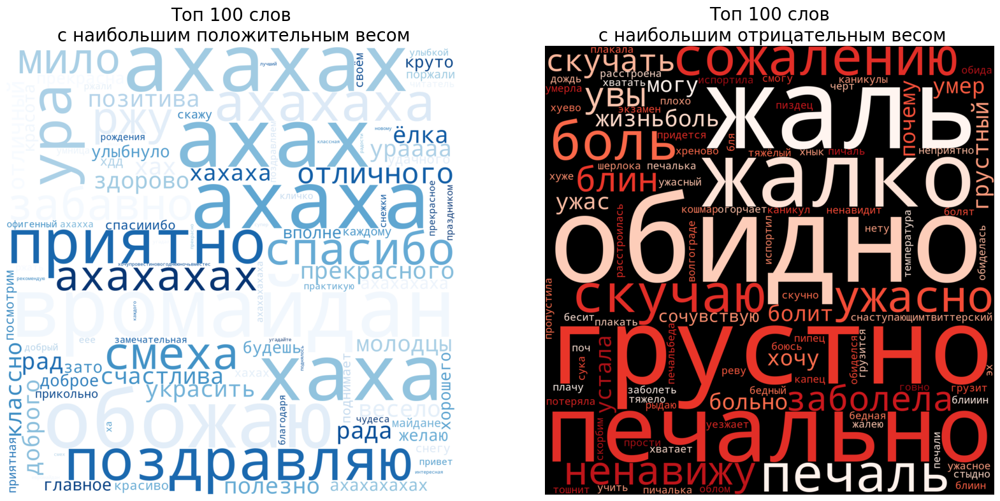

In [91]:
# Выведем картинки сгенерированные вордклаудом
fig, ax = plt.subplots(1, 2, figsize = (20, 12))


ax[0].imshow(wordcloud_positive, interpolation='bilinear')
ax[1].imshow(wordcloud_negative, interpolation='bilinear')

ax[0].set_title('Топ ' +\
                str(weights_max.shape[0]) +\
                ' слов\n с наибольшим положительным весом',
               fontsize = 20
               )
ax[1].set_title('Топ ' +\
                str(weights_min.shape[0]) +\
                ' слов\n с наибольшим отрицательным весом',
               fontsize = 20
               )

ax[0].axis("off")
ax[1].axis("off")

plt.show()

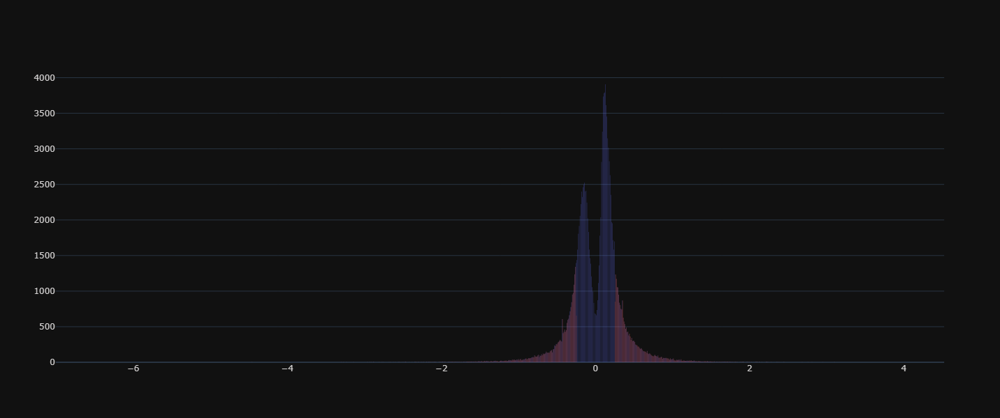

In [92]:
fig = make_subplots(1,1)

fig.add_trace(go.Histogram(
    x = weights.query('weights != 0')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.add_trace(go.Histogram(
    x = weights.query('weights > 0.25 or weights < -0.25')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    
)

In [93]:
vocab = weights.query('weights > 0.25 or weights < -0.25')['words']

In [94]:
vocab

1               ааа
2              аааа
3             ааааа
4            аааааа
5           ааааааа
            ...    
170331          ёще
170334    ёёлочкууу
170335       ёёпрст
170340         ёёёё
170342       ёёёёёё
Name: words, Length: 45950, dtype: object

In [95]:
count_idf = TfidfVectorizer(vocabulary=vocab,
                            ngram_range=(1,1))

In [96]:
tf_idf = count_idf.fit_transform(joned_text['text'])

tf_idf_train = count_idf.transform(train['text'])
tf_idf_test = count_idf.transform(test['text'])

In [97]:
display(tf_idf_test.shape)
display(tf_idf_train.shape)

(45368, 45950)

(181468, 45950)

In [98]:
model_lr_base = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

In [99]:
model_lr_base.fit(tf_idf_train, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [100]:
predict_lr_base_proba_1 = model_lr_base.predict_proba(tf_idf_test)

In [101]:
fpr_base_1, tpr_base_1, _ = roc_curve(test['label'], predict_lr_base_proba_1[:, 1])
roc_auc_base_1 = auc(fpr_base_1, tpr_base_1)

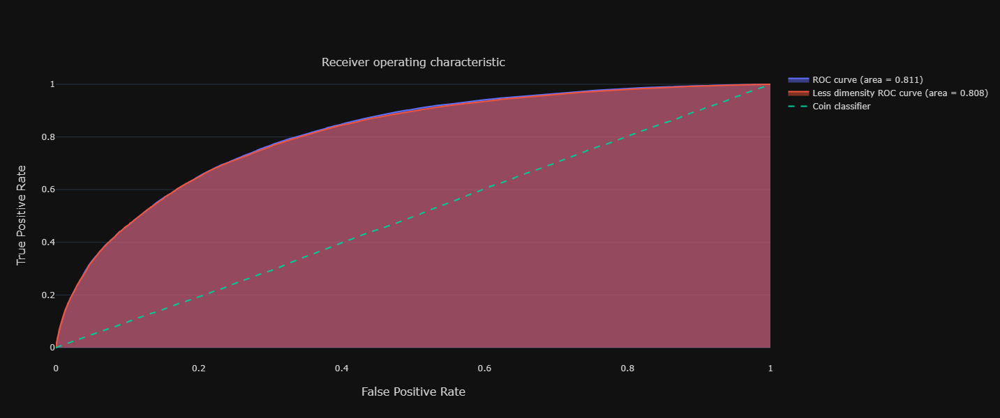

In [102]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    fill = 'tozeroy',
    name = "ROC curve (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base_1,
    y = tpr_base_1,
    fill = 'tozeroy',
    name = "Less dimensity ROC curve (area = %0.3f)" % roc_auc_base_1,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

In [103]:
scores = {}

weight = 0.55

for threshold in np.linspace(0, 1, 100):
    
    matrix = confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 0] <  threshold).astype('float'),
                 normalize='true',
                )

    score = matrix[0,0] * weight + matrix[1,1] * (1 - weight)
    
    scores[threshold] = score

In [104]:
pd.DataFrame({'true_score':scores.values(),
             'threshold':scores.keys()},
             ).sort_values(by = 'true_score', ascending = False).head()

,true_score,threshold
45,0.734298,0.454545
44,0.734271,0.444444
46,0.733860,0.464646
43,0.733731,0.434343
47,0.732736,0.474747


In [105]:
matrix = confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 0] <  0.444444).astype('int'),
                 normalize='true',
                )
matrix

array([[0.78080844, 0.21919156],
       [0.3225526 , 0.6774474 ]])

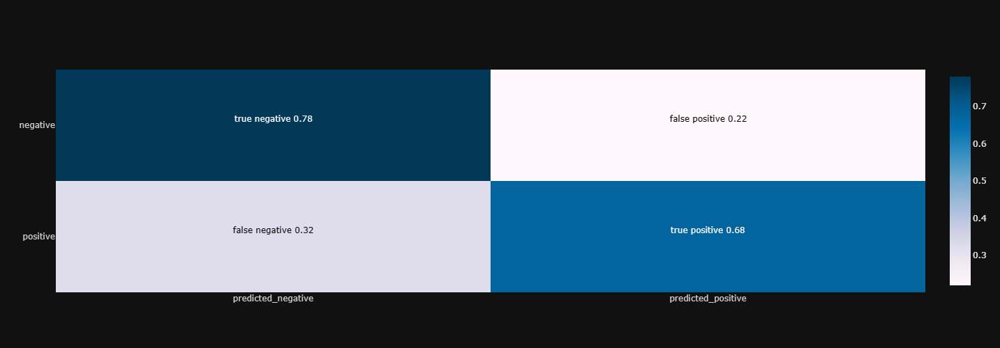

In [106]:
# Сделаем красивый график матрицы ошибок

fig = make_subplots(1,1)

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_annotation(x=0, y=0,
            text = "false negative " + str(round(matrix[1,0], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=1,
            text = "false positive " + str(round(matrix[0,1], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=0,
            text = "true positive " + str(round(matrix[1,1], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)

fig.add_annotation(x=0, y=1,
            text = "true negative " + str(round(matrix[0,0], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)


fig.update_layout(height = 500,
                  width = 500,
                  template = 'plotly_dark',
                  font_color = 'rgba(212, 210, 210, 1)',
                 ).show()